In [42]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import HDBSCAN
from sklearn.cluster import OPTICS
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import altair as alt
import seaborn as sns
alt.data_transformers.disable_max_rows()


DataTransformerRegistry.enable('default')

In [43]:
df = pd.read_csv('SO_ML_2022_cleaned.csv')
df = df.drop(columns=['Unnamed: 0'])
df_so_data = df.copy()
df.head()

,fractional_year,O7_O6_ratio,C6_C4_ratio,C6_C5_ratio,Fe_O_ratio,O_ave_charge,velocity,density
0,2022.049316,0.089865,2.458390,0.444265,0.150213,6.074951,494.797,2.82344
1,2022.049335,0.083158,2.841864,0.410422,0.160867,6.072842,489.727,2.96590
2,2022.049354,0.098469,2.527932,0.328493,0.132257,6.086165,491.465,2.65348
3,2022.049373,0.070984,2.794871,0.356665,0.135882,6.060820,490.259,2.89073
4,2022.049392,0.078036,1.416381,0.329367,0.154701,6.068972,493.497,2.96546


### Correlations

In [44]:
df_corr = df.corr()
df_corr

,fractional_year,O7_O6_ratio,C6_C4_ratio,C6_C5_ratio,Fe_O_ratio,O_ave_charge,velocity,density
fractional_year,1.000000,-0.091760,-0.113547,-0.109207,-0.023825,-0.026817,0.019199,0.104320
O7_O6_ratio,-0.091760,1.000000,0.539937,0.552404,0.264880,0.914527,-0.491470,0.171348
C6_C4_ratio,-0.113547,0.539937,1.000000,0.773682,-0.038401,0.495198,-0.474612,-0.000416
C6_C5_ratio,-0.109207,0.552404,0.773682,1.000000,-0.056638,0.506321,-0.524439,0.005065
Fe_O_ratio,-0.023825,0.264880,-0.038401,-0.056638,1.000000,0.193546,-0.066951,0.232137
O_ave_charge,-0.026817,0.914527,0.495198,0.506321,0.193546,1.000000,-0.496352,0.174769
velocity,0.019199,-0.491470,-0.474612,-0.524439,-0.066951,-0.496352,1.000000,-0.287008
density,0.104320,0.171348,-0.000416,0.005065,0.232137,0.174769,-0.287008,1.000000


<Axes: >

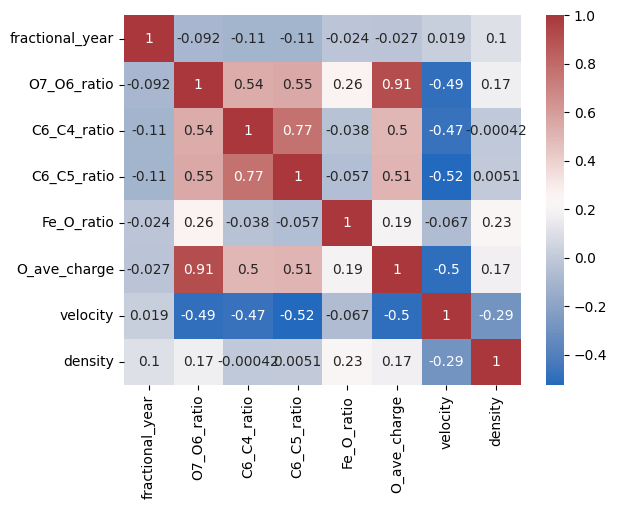

In [45]:
sns.heatmap(df_corr, annot=True, cmap="vlag")

### Preprocessing

In [46]:
# scale the data using min/max scaler
cols = df.columns.tolist()[1:]
scaler = MinMaxScaler()
data_scaled = scaler.fit_transform(df[cols])


### PCA

In [47]:
pca = PCA()
pca.fit(data_scaled)
print(pca.explained_variance_ratio_)

[0.63160578 0.16930218 0.15016947 0.03154353 0.00872087 0.00535277
 0.0033054 ]


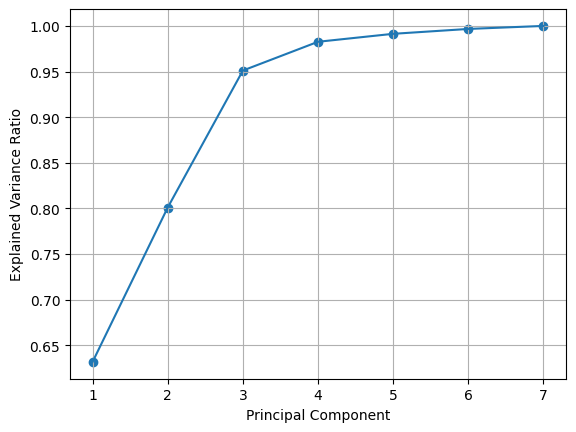

In [48]:
plt.plot(range(1,len(pca.explained_variance_ratio_)+1), pca.explained_variance_ratio_.cumsum())
plt.scatter(range(1,len(pca.explained_variance_ratio_)+1), pca.explained_variance_ratio_.cumsum())
plt.ylabel('Explained Variance Ratio')
plt.xlabel('Principal Component')
plt.grid()
plt.show()

- Use 3 principal components for 95% of the explained variance

In [49]:
pca = PCA(n_components=3)
data_pca = pca.fit_transform(data_scaled)
df_pca = pd.DataFrame(data_pca, columns=['PC1', 'PC2', 'PC3'])

## K-means clustering

#### Deteriming Optimal K

Text(0.5, 0, 'K Value')

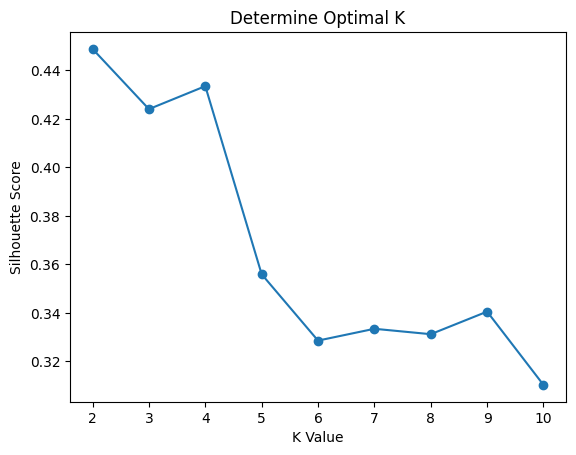

In [50]:
k_vals = list(range(2,11))

sil_scores = []
for k in k_vals:
    model = KMeans(n_clusters=k, random_state=0, n_init='auto').fit(df_pca)
    labels = model.labels_
    sil_scores.append(silhouette_score(df_pca, labels))

plt.plot(k_vals, sil_scores)
plt.scatter(k_vals, sil_scores)
plt.title('Determine Optimal K')
plt.ylabel('Silhouette Score')
plt.xlabel('K Value')

### K = 2

In [51]:
model = KMeans(n_clusters=2, random_state=0, n_init='auto').fit(df_pca)
labels = model.labels_

df_pca_labelled = df_pca.copy()
df_pca_labelled['Cluster_Label'] = labels
df_pca_labelled['Cluster_Label'] = df_pca_labelled.Cluster_Label.astype('category')

df_so_data_labelled = df_so_data.copy()
df_so_data_labelled['Cluster_Label'] = labels
df_so_data_labelled['Cluster_Label'] = df_so_data_labelled.Cluster_Label.astype('category')

print(f"The silhoette score for K = 2: {silhouette_score(df_pca, labels)}")

The silhoette score for K = 2: 0.4488119837451749


In [52]:
chart1 = alt.Chart(df_pca_labelled).mark_circle().encode(
    x='PC1',
    y='PC2',
    color='Cluster_Label'
)

chart2 = alt.Chart(df_pca_labelled).mark_circle().encode(
    x='PC2',
    y='PC3',
    color='Cluster_Label'
)

chart3 = alt.Chart(df_pca_labelled).mark_circle().encode(
    x='PC1',
    y='PC3',
    color='Cluster_Label'
)

chart1 | chart2 | chart3

alt.HConcatChart(...)

In [53]:
features = df_so_data_labelled.columns[1:-1].tolist()
charts = []
for feature in features:
    y_var = 'mean(' + feature + ')'
    chart = alt.Chart(df_so_data_labelled).mark_bar().encode(
        x='Cluster_Label:O',
        y=alt.Y(y_var)
    ).properties(
        width = 200,
        height = 500
    )

    error_bars = alt.Chart(df_so_data_labelled).mark_errorbar(extent='stderr').encode(
        x='Cluster_Label',
        y=feature
    )

    chart = alt.layer(chart, error_bars)
    charts.append(chart)
alt.hconcat(*charts)

alt.HConcatChart(...)

## DBSCAN

Text(0, 0.5, 'Distance')

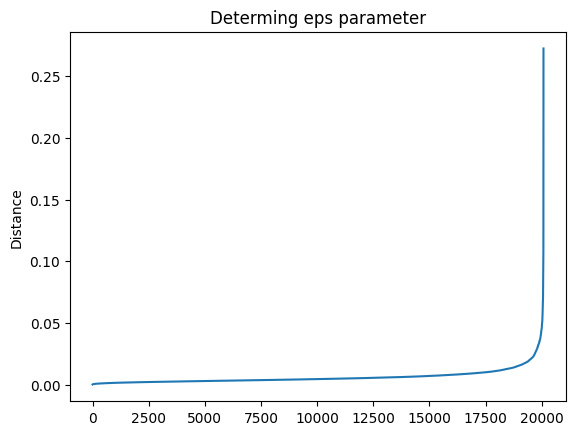

In [54]:
# determine the eps value
KNN = NearestNeighbors(n_neighbors=6)
neighbors = KNN.fit(df_pca)
distances, indices = neighbors.kneighbors(df_pca)

distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)
plt.title('Determing eps parameter')
plt.ylabel('Distance')

min_samples value is: 60
{0, 1, -1}
0.12181986710132253
min_samples value is: 65
{0, -1}
0.3254006957310491
min_samples value is: 70
{0, -1}
0.3208835635789486
min_samples value is: 75
{0, -1}
0.31686964641369875
min_samples value is: 80
{0, -1}
0.312765629804966
min_samples value is: 85
{0, 1, -1}
-0.03119756215476578


Text(0.5, 0, 'min # samples')

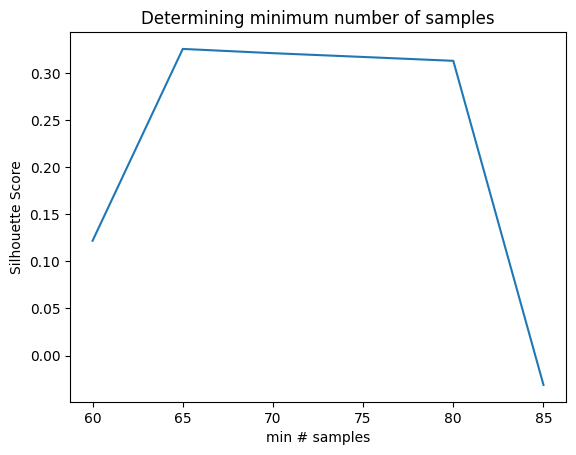

In [55]:
min_samples = [60, 65, 70, 75, 80, 85]
scores = []
for i in min_samples:
    print("min_samples value is: " + str(i))
    db = DBSCAN(eps=0.03, min_samples=i).fit(df_pca)
    print(set(db.labels_))
    silhouette_avg = silhouette_score(df_pca, db.labels_)
    print(silhouette_avg)
    scores.append(silhouette_avg)

plt.plot(min_samples, scores)
plt.title('Determining minimum number of samples')
plt.ylabel('Silhouette Score')
plt.xlabel('min # samples') 

eps value is: 0.037
{0, 1, -1}
For eps value = 0.037 The average silhoette score is : 0.11118027758513477
eps value is: 0.038
{0, -1}
For eps value = 0.038 The average silhoette score is : 0.3956792108151644
eps value is: 0.039
{0, -1}
For eps value = 0.039 The average silhoette score is : 0.4024071535459385
eps value is: 0.04
{0, 1, -1}
For eps value = 0.04 The average silhoette score is : 0.17541377839394404
eps value is: 0.041
{0, 1, -1}
For eps value = 0.041 The average silhoette score is : 0.18166018080515356
eps value is: 0.042
{0, 1, -1}
For eps value = 0.042 The average silhoette score is : 0.18624211503080834
eps value is: 0.043
{0, 1, -1}
For eps value = 0.043 The average silhoette score is : 0.18999994838846612


Text(0.5, 0, 'eps')

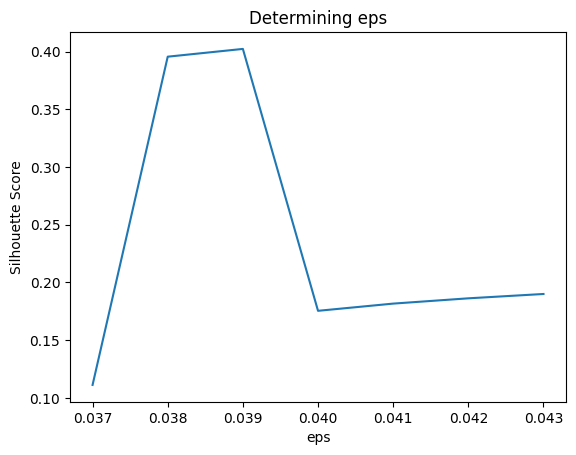

In [56]:
range_eps = [0.037, 0.038, 0.039, 0.04, 0.041, 0.042, 0.043]
scores = []
for i in range_eps:
    print("eps value is: " + str(i))
    db = DBSCAN(eps=i, min_samples=65).fit(df_pca)
    # core_samples_mask = np.zeros_like(db.labels_, type=bool)
    # core_samples_mask[db.core_sample_indices_] = True
    labels = db.labels_
    print(set(labels))
    silhouette_avg = silhouette_score(df_pca, labels)
    print("For eps value = " + str(i) + " The average silhoette score is : " + str(silhouette_avg))
    scores.append(silhouette_avg)

plt.plot(range_eps, scores)
plt.title('Determining eps')
plt.ylabel('Silhouette Score')
plt.xlabel('eps') 

#### Final DBSCAN Model

In [57]:
db = DBSCAN(eps=0.039, min_samples=65).fit(df_pca)
labels = db.labels_

df_pca_labelled = df_pca.copy()
df_pca_labelled['Cluster_Label'] = labels
df_pca_labelled['Cluster_Label'] = df_pca_labelled.Cluster_Label.astype('category')

df_so_data_labelled = df_so_data.copy()
df_so_data_labelled['Cluster_Label'] = labels
df_so_data_labelled['Cluster_Label'] = df_so_data_labelled.Cluster_Label.astype('category')

print(f"The silhouette score of the final model is: {silhouette_score(df_pca, labels)}")

The silhouette score of the final model is: 0.4024071535459385


#### Scatter Plots

In [58]:
chart1 = alt.Chart(df_pca_labelled).mark_circle().encode(
    x='PC1',
    y='PC2',
    color='Cluster_Label'
)

chart2 = alt.Chart(df_pca_labelled).mark_circle().encode(
    x='PC2',
    y='PC3',
    color='Cluster_Label'
)

chart3 = alt.Chart(df_pca_labelled).mark_circle().encode(
    x='PC1',
    y='PC3',
    color='Cluster_Label'
)

chart1 | chart2 | chart3

alt.HConcatChart(...)

#### Bar Charts

In [59]:
features = df_so_data_labelled.columns[1:-1].tolist()
charts = []
for feature in features:
    y_var = 'mean(' + feature + ')'
    chart = alt.Chart(df_so_data_labelled).mark_bar().encode(
        x='Cluster_Label:O',
        y=alt.Y(y_var)
    ).properties(
        width = 200,
        height = 500
    )

    error_bars = alt.Chart(df_so_data_labelled).mark_errorbar(extent='stderr').encode(
        x='Cluster_Label',
        y=feature
    )

    chart = alt.layer(chart, error_bars)
    charts.append(chart)
alt.hconcat(*charts)

alt.HConcatChart(...)

## HDBSCAN

#### Final HDBSCAN Model

In [60]:
hdb = HDBSCAN(min_cluster_size=20, min_samples=30).fit(df_pca)
labels = hdb.labels_

df_pca_labelled = df_pca.copy()
df_pca_labelled['Cluster_Label'] = labels
df_pca_labelled['Cluster_Label'] = df_pca_labelled.Cluster_Label.astype('category')

df_so_data_labelled = df_so_data.copy()
df_so_data_labelled['Cluster_Label'] = labels
df_so_data_labelled['Cluster_Label'] = df_so_data_labelled.Cluster_Label.astype('category')

print(f"The silhouette score of the final model is: {silhouette_score(df_pca, labels)}")


The silhouette score of the final model is: 0.15884589690876297


In [61]:
chart1 = alt.Chart(df_pca_labelled).mark_circle().encode(
    x='PC1',
    y='PC2',
    color='Cluster_Label'
)

chart2 = alt.Chart(df_pca_labelled).mark_circle().encode(
    x='PC2',
    y='PC3',
    color='Cluster_Label'
)

chart3 = alt.Chart(df_pca_labelled).mark_circle().encode(
    x='PC1',
    y='PC3',
    color='Cluster_Label'
)

chart1 | chart2 | chart3

alt.HConcatChart(...)

In [62]:
features = df_so_data_labelled.columns[1:-1].tolist()
charts = []
for feature in features:
    y_var = 'mean(' + feature + ')'
    chart = alt.Chart(df_so_data_labelled).mark_bar().encode(
        x='Cluster_Label:O',
        y=alt.Y(y_var)
    ).properties(
        width = 200,
        height = 500
    )

    error_bars = alt.Chart(df_so_data_labelled).mark_errorbar(extent='stderr').encode(
        x='Cluster_Label',
        y=feature
    )

    chart = alt.layer(chart, error_bars)
    charts.append(chart)
alt.hconcat(*charts)

alt.HConcatChart(...)